# Filter Bank for cognitive modeling

This document is intended as a supplement to the GCT731 Music Cognitive Science class. This material refer, 
- [MIR CCRMA](https://musicinformationretrieval.com/index.html), 
- [Python Notebooks for Fundamentals of Music Processing](https://www.audiolabs-erlangen.de/resources/MIR/FMP/C0/C0.html), 
- [GCT634 Musical Applications of Machine Learning
](http://mac.kaist.ac.kr/~juhan/gct634/)

As you may know, music cognitive science is the 700th subject. Therefore, it is recommended to study the basic contents by investing a separate time.

TA: SeungHeonDoh
- seungheondoh@kaist.ac.kr
- Master student @Music and Audio Computing Lab | Graduate School of Culture Technology (GSCT)

### Contents

- Bandpass filter

In [1]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import IPython.display as ipd

filename = './src/sample.mp3'

In [2]:
samples, sample_rate = librosa.load(filename, sr=22050)

/Users/seungheondoh/Autotagging/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


In [3]:
len(samples), len(samples)/sample_rate

(3541248, 160.6008163265306)

In [4]:
ipd.Audio(samples, rate=sample_rate)

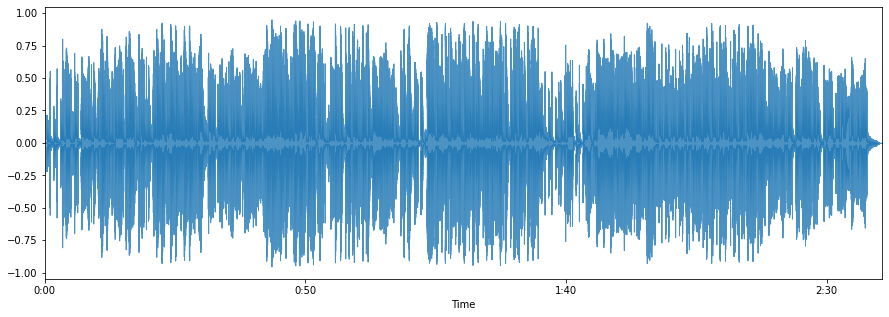

In [5]:
plt.figure(figsize=(15, 5))
librosa.display.waveplot(samples, sample_rate, alpha=0.8)

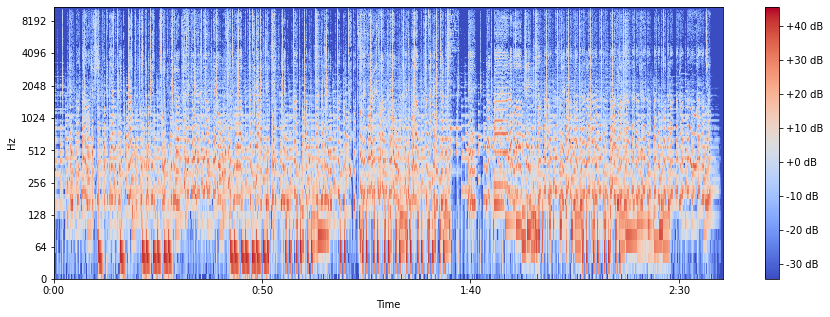

In [6]:
X = librosa.core.stft(samples, n_fft=1024, hop_length=512, win_length=1024)
S = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(15, 5))
librosa.display.specshow(S, sr=sample_rate, hop_length=512, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

## Filter Change

Filter type - btype{‘lowpass’, ‘highpass’, ‘bandpass’, ‘bandstop’}

In [7]:
import numpy as np
from scipy.signal import butter, lfilter, freqz
import matplotlib.pyplot as plt

def butter_pass(cutoff, fs, btype, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype=btype, analog=False)
    return b, a

def butter_filter(data, cutoff, fs, btype, order=5):
    b, a = butter_pass(cutoff, fs, btype, order=order)
    y = lfilter(b, a, data)
    return y

### Low pass filter

In [8]:
# Filter requirements.
order = 6
fs = 22050     # sample rate, Hz
cutoff = 2048  # desired cutoff frequency of the filter, Hz

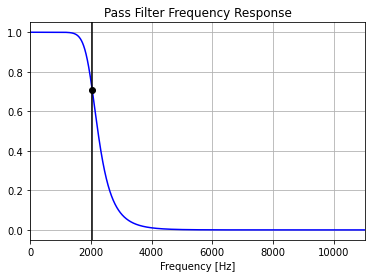

In [9]:
# Get the filter coefficients so we can check its frequency response.
b, a = butter_pass(cutoff, fs, 'lowpass',order)

# Plot the frequency response.
w, h = freqz(b, a, worN=8000)

plt.plot(0.5*fs*w/np.pi, np.abs(h), 'b')
plt.plot(cutoff, 0.5*np.sqrt(2), 'ko')
plt.axvline(cutoff, color='k')
plt.xlim(0, 0.5*fs)
plt.title("Pass Filter Frequency Response")
plt.xlabel('Frequency [Hz]')
plt.grid()

In [10]:
T = len(samples)/sample_rate   # seconds
n = int(T * sample_rate) # total number of samples
t = np.linspace(0, T, n, endpoint=False)

# Filter the data, and plot both the original and filtered signals.
y = butter_filter(samples, cutoff, fs, 'lowpass', order)

In [11]:
ipd.Audio(y, rate=sample_rate)

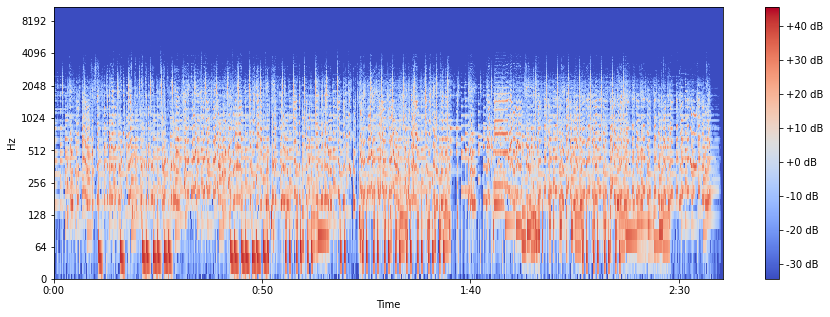

In [12]:
X = librosa.core.stft(y, n_fft=1024, hop_length=512, win_length=1024) # get frequency to STFT
S = librosa.amplitude_to_db(abs(X)) # Change Amplitude to decibel
plt.figure(figsize=(15, 5)) # get figure size
librosa.display.specshow(S, sr=sample_rate, hop_length=512, x_axis='time', y_axis='log') #display
plt.colorbar(format='%+2.0f dB')

### Highpass filter

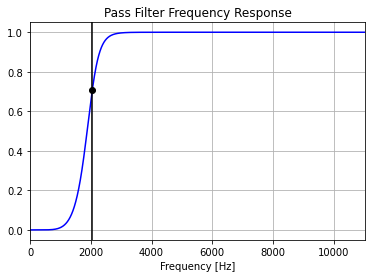

In [13]:
# Get the filter coefficients so we can check its frequency response.
b, a = butter_pass(cutoff, fs, 'highpass',order)

# Plot the frequency response.
w, h = freqz(b, a, worN=8000)

plt.plot(0.5*fs*w/np.pi, np.abs(h), 'b')
plt.plot(cutoff, 0.5*np.sqrt(2), 'ko')
plt.axvline(cutoff, color='k')
plt.xlim(0, 0.5*fs)
plt.title("Pass Filter Frequency Response")
plt.xlabel('Frequency [Hz]')
plt.grid()

In [14]:
T = len(samples)/sample_rate   # seconds
n = int(T * sample_rate) # total number of samples
t = np.linspace(0, T, n, endpoint=False)
# Filter the data, and plot both the original and filtered signals.
y = butter_filter(samples, cutoff, fs, 'highpass', order)
ipd.Audio(y, rate=sample_rate)

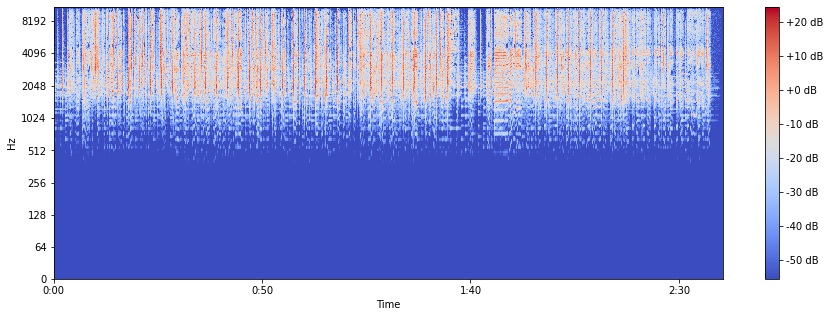

In [15]:
X = librosa.core.stft(y, n_fft=1024, hop_length=512, win_length=1024)
S = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(15, 5))
librosa.display.specshow(S, sr=sample_rate, hop_length=512, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

### Bandwidth Filter

In [16]:
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

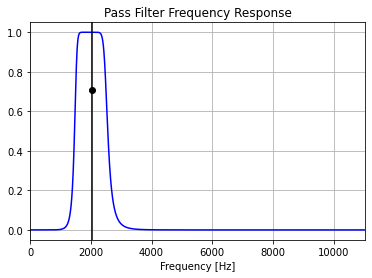

In [17]:
lowcut = 1500
highcut = 2500

b, a = butter_bandpass(lowcut, highcut, fs ,order)

# Plot the frequency response.
w, h = freqz(b, a, worN=8000)

plt.plot(0.5*fs*w/np.pi, np.abs(h), 'b')
plt.plot(cutoff, 0.5*np.sqrt(2), 'ko')
plt.axvline(cutoff, color='k')
plt.xlim(0, 0.5*fs)
plt.title("Pass Filter Frequency Response")
plt.xlabel('Frequency [Hz]')
plt.grid()

In [18]:
T = len(samples)/sample_rate   # seconds
n = int(T * sample_rate) # total number of samples
t = np.linspace(0, T, n, endpoint=False)

# Filter the data, and plot both the original and filtered signals.
y = butter_bandpass_filter(samples, lowcut, highcut, fs, order=5)
ipd.Audio(y, rate=sample_rate)

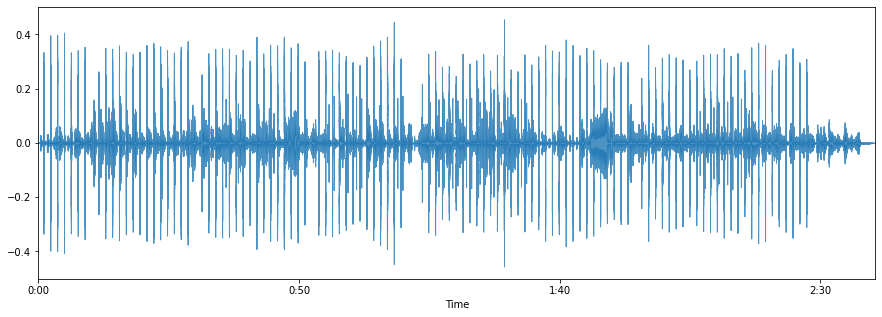

In [21]:
plt.figure(figsize=(15, 5))
librosa.display.waveplot(y, sample_rate, alpha=0.8)

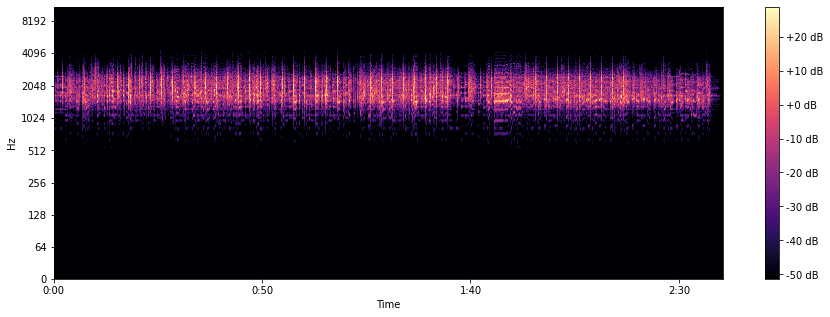

In [19]:
X = librosa.core.stft(y, n_fft=1024, hop_length=512, win_length=1024)
S = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(15, 5))
librosa.display.specshow(S, sr=sample_rate, hop_length=512, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')